Initialise  
Mid price - classification rather than, 
Label - neural network (Random Forest)
mid-price

In [36]:
import numpy as np
import pandas as pd
from statsmodels.tsa.stattools import adfuller
from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt
import glob
import re
from datetime import datetime

Import Data

In [37]:
data_read = pd.read_csv('data_min_total.csv')
data_read['DateTime_Minute'] = pd.to_datetime(data_read['DateTime_Minute'], format='%Y-%m-%d %H:%M:%S')
# Jan to May (Train)
data = data_read[data_read['DateTime_Minute'] <= '2025-05-31'].copy()

Get a df with just time and mid-price

In [103]:
arima_df = pd.DataFrame()
arima_df['Mid-Price'] = data['Mid-Price']
arima_df['Bid-Ask Spread'] = data['Bid_Ask_Spread']
arima_df.set_index(data.index, inplace=True)
arima_df.reset_index(drop=True, inplace=True)

print(type(arima_df))
print(arima_df.to_string(index=True, header=True))
mid_price = arima_df['Mid-Price'] 

arima_df.to_csv('ARIMA Input.csv')

<class 'pandas.core.frame.DataFrame'>


       Mid-Price  Bid-Ask Spread
0         265.93            8.17
1         261.32            5.29
2         265.43            4.65
3         265.11            4.18
4         265.93            5.50
5         263.16            4.69
6         261.39            7.49
7         263.18            4.68
8         264.03            6.36
9         264.86            5.02
10        268.02            5.25
11        266.13            4.82
12        264.37            6.95
13        259.69            6.82
14        258.15            6.46
15        281.05           37.03
16        266.19           13.65
17        281.52           37.95
18        269.36           16.08
19        269.27           15.30
20        268.90           12.44
21        266.35           19.76
22        261.89            9.90
23        281.07           35.99
24        268.60           20.20
25        284.15           42.44
26        265.12           12.29
27        260.89            5.53
28        255.81            4.81
29        

Split the data 80:20 by time

52512    148.76
52513    134.32
52514    140.71
52515    142.66
52516    138.15
Name: Mid-Price, dtype: float64


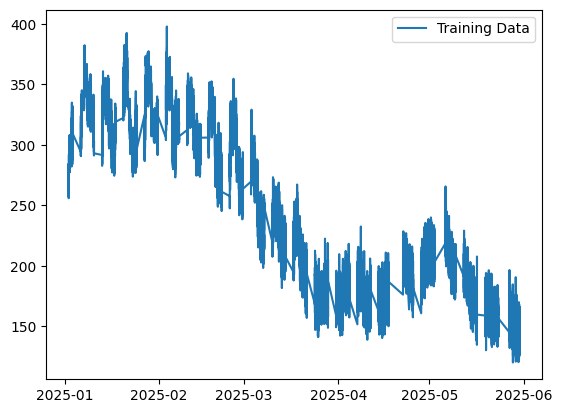

In [ ]:
# Split the DataFrame into train and test sets based on the split index
train = (arima_df['Mid-Price'])
print(train.tail())
plt.plot(data['DateTime_Minute'], data['Mid-Price'], label = 'Training Data')
plt.legend()
plt.show()


Do ADF Test to check if data is stationary 

In [41]:
#Ho: It is non stationary
#H1: It is stationary
def adfuller_test(mid_price):
    result=adfuller(mid_price)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary")
    else:
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")

adfuller_test(mid_price)

ADF Test Statistic : -0.993094534801097
p-value : 0.7557745709854997
#Lags Used : 46
Number of Observations Used : 52470
weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 


Plot ACF

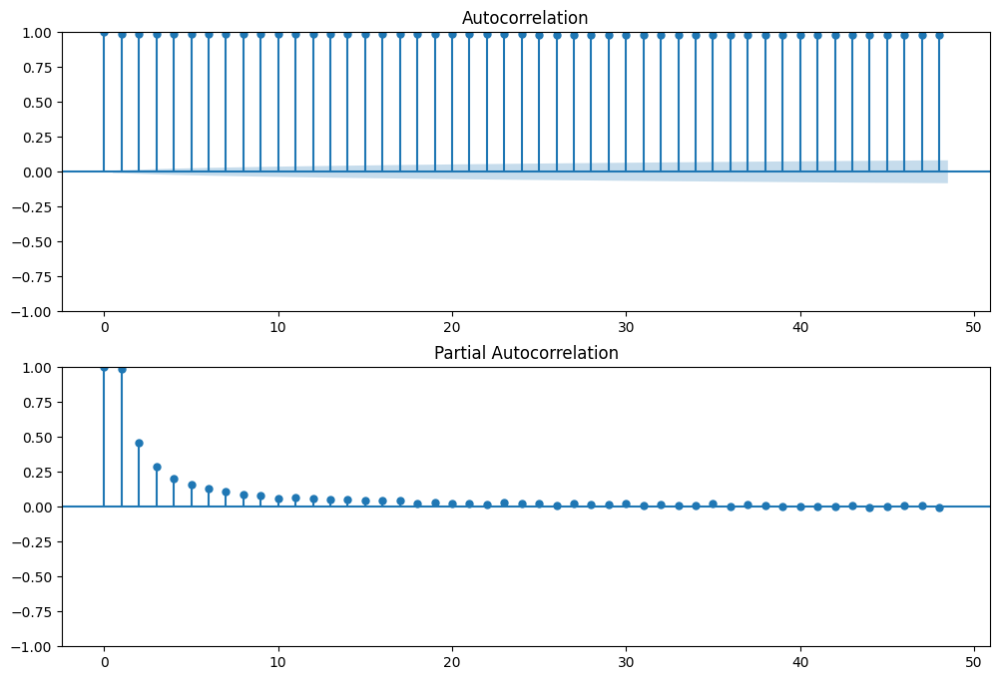

In [42]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

fig, ax = plt.subplots(2, 1, figsize=(12, 8))
plot_acf(arima_df['Mid-Price'], ax=ax[0])  # ACF plot for 'Mid-Price'
plot_pacf(arima_df['Mid-Price'], ax=ax[1])  # PACF plot for 'Mid-Price'

plt.show()

Use pdarima package to check d calc

In [43]:
from pmdarima.arima.utils import ndiffs 
ndiffs(train, test = "adf")

0

Plot interpretation

ACF Plot Interpretation:

The ACF plot tails off gradually, which indicates that the data may be either an AR process or a mixed ARMA process. In an ACF plot for a pure MA process, we would expect a sharp cut-off after the significant lags. Therefore p = 1.

PACF Plot Interpretation:

The PACF plot shows a significant spike at lag 1, and then it almost immediately cuts off (becomes insignificant). Given the lack of significant spikes in the ACF plot beyond the immediate lag, I will start with q=0 and test q=1 as well.

Differencing Term (d):

As per the ADF test, the data is stationary so d = 0




Do ARIMA Test

In [44]:
print(train)

0        265.93
1        261.32
2        265.43
3        265.11
4        265.93
          ...  
52512    148.76
52513    134.32
52514    140.71
52515    142.66
52516    138.15
Name: Mid-Price, Length: 52517, dtype: float64


In [46]:
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA

# Use auto_arima to find the best ARIMA parameters
auto_model = auto_arima(train, seasonal=False, trace=True)
# Print the summary of the best model
print(auto_model.summary())
# Extract the best order
best_order = auto_model.order
print("Best ARIMA order:", best_order)

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=367643.271, Time=38.77 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=392728.561, Time=0.71 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=380129.022, Time=0.90 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=368494.294, Time=4.71 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=392726.564, Time=0.38 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=367644.169, Time=25.65 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=367748.454, Time=11.27 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=367740.241, Time=14.95 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=367644.610, Time=25.52 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=367938.876, Time=6.29 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=367643.356, Time=40.19 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=367688.921, Time=15.69 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=367647.241, Time=50.89 sec
 ARIMA(2,1,2)(0,0,0)[0]             : AIC=367641.798, Time=14.97 

In [ ]:
auto_model = auto_arima(train, start_p=1, start_q=1, max_p=2, max_q=2,
                        start_P=0, start_Q=0, max_P=2, max_Q=2,
                        m=12, seasonal=True, d=1, D=1, trace=True,
                        error_action='ignore', suppress_warnings=True,
                        stepwise=True)
print(auto_model.summary())

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=inf, Time=23.96 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=428880.525, Time=2.32 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=400973.385, Time=11.86 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=53.69 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=416187.550, Time=2.89 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=395178.707, Time=30.71 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=362.24 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=87.76 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=408075.343, Time=31.59 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=390660.501, Time=64.59 sec
 ARIMA(2,1,0)(1,1,0)[12]             : AIC=396577.560, Time=28.33 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=inf, Time=445.55 sec


MemoryError: Unable to allocate 292. MiB for an array with shape (27, 27, 52518) and data type float64

In [ ]:
horizon = 5  # Predicting the next 5 steps
training_window = 20  # Look back window for training

predictions = []
actuals = []

# Ensure the loop starts at 'training_window' to have the first set of 20 data points
for end in range(training_window, len(arima_df) - horizon + 1):
    
    # Extract current training data (last 20 data points)
    train_set = train.iloc[end - training_window:end]
    
    # Fit the ARIMA model with the chosen order
    model = ARIMA(train_set, order=best_order)  # Ensure you've chosen the best order
    model_fit = model.fit()
    
    # Forecast the next 5 points
    forecast = model_fit.forecast(steps=horizon)
    
    # Append the forecasted values
    predictions.extend(forecast)  # Assuming 'forecast' returns a list of predictions
    
    # Append the actual values for comparison
    actuals.extend(arima_df['Mid-Price'].iloc[end:end + horizon])

C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregre

LinAlgError: LU decomposition error.

In [ ]:
from sklearn.metrics import mean_squared_error
error = mean_squared_error(actuals, predictions)
print('Test Mean Squared Error:', error)

print(predictions)
print(actuals)

Test Mean Squared Error: 51.60377679406017
[268.78990018885384, 266.94984638934534, 268.22416987016237, 267.951269954841, 268.00971223021577, 267.1050193960719, 268.3586321691886, 268.1224174737898, 268.169103287781, 268.1598762359909, 267.1542290945562, 266.4624096199462, 266.5570414077846, 266.5515167806881, 266.55183930977955, 265.56649500913903, 263.5125815071207, 266.51617425556225, 266.28637944098614, 266.30396027208695, 265.449017768434, 277.170330731829, 266.8856879718295, 270.0963341613823, 269.09403887558176, 278.82718568772646, 269.02184588400564, 270.77895161682113, 270.2625729452283, 270.41432643820036, 269.53275771916054, 274.90616816073504, 270.7030711210111, 272.162409697328, 271.65571925925366, 272.62938900749504, 265.6078128273064, 269.62027683070875, 268.2965287603262, 268.73324519002017, 263.3315013061105, 259.41959061893044, 269.7060485675689, 267.50745650538096, 267.9773759937074, 257.5472764157925, 264.18534675588444, 267.7374400142296, 266.9888618203015, 267.146

Plot

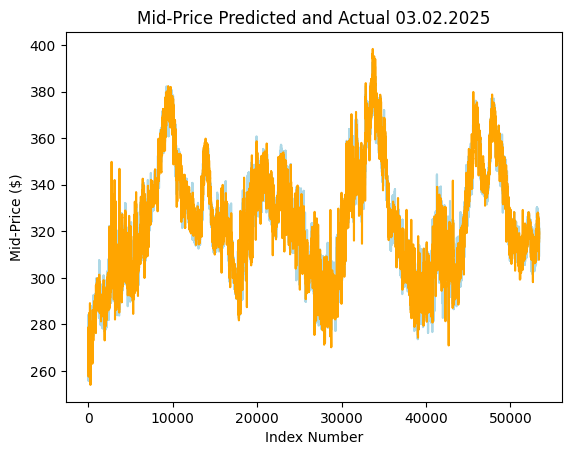

In [ ]:
plt.plot(actuals, color = 'lightblue', label = 'Actual')
plt.plot(predictions, color = 'orange', label = 'Predicted')
plt.title('Mid-Price Predicted and Actual 03.02.2025')
plt.xlabel('Index Number')
plt.ylabel('Mid-Price ($)')
plt.show()

In [ ]:
mid_price_pred = pd.DataFrame()
mid_price_pred['Actual'] = actuals
mid_price_pred['Predicted'] = predictions

mid_price_pred.to_csv('Predicted Mid-Price (Month).csv')

In [67]:
test_data = data_read[(data_read['DateTime_Minute'] >= '2025-06-01') & (data_read['DateTime_Minute'] < '2025-07-01')].copy()
arima_test_df = pd.DataFrame()
arima_test_df['Mid-Price'] = test_data['Mid-Price']
arima_test_df['Bid_Ask_Spread'] = test_data['Bid_Ask_Spread']
arima_test_df['Date'] = pd.to_datetime(test_data['DateTime_Minute'])
arima_test_df.set_index('Date', inplace=True)
#arima_test_df.head(20)

Get data for Mid-Price prediction

In [68]:
test_mid = arima_test_df['Mid-Price']
test_mid.index = pd.to_datetime(test_data['DateTime_Minute'])  # Set datetime index if not already set
test_mid.head(20)

DateTime_Minute
2025-06-02 07:30:00    129.63
2025-06-02 07:31:00    135.20
2025-06-02 07:32:00    136.63
2025-06-02 07:33:00    150.86
2025-06-02 07:34:00    134.52
2025-06-02 07:35:00    160.80
2025-06-02 07:36:00    143.31
2025-06-02 07:37:00    144.38
2025-06-02 07:38:00    134.25
2025-06-02 07:39:00    138.13
2025-06-02 07:40:00    127.10
2025-06-02 07:41:00    138.90
2025-06-02 07:42:00    141.31
2025-06-02 07:43:00    144.97
2025-06-02 07:44:00    130.96
2025-06-02 07:45:00    129.08
2025-06-02 07:46:00    150.06
2025-06-02 07:47:00    143.86
2025-06-02 07:48:00    141.06
2025-06-02 07:49:00    146.31
Name: Mid-Price, dtype: float64

Run ARIMA using PACF and ACF Plots

In [64]:
horizon = 5  # Predicting the next 5 steps
training_window = 20  # Look back window for training

predictions_test = []
actuals_test = []

# Ensure the loop starts at 'training_window' to have the first set of 20 data points
for end in range(training_window, len(test_mid) - horizon + 1):
    
    # Extract current training data
    test_set = test_mid.iloc[end - training_window:end]
    
    # Fit the ARIMA model with the chosen order
    model = ARIMA(test_set, order=(1,1,0))  # Ensure you've chosen the best order
    model_fit = model.fit()
    
    # Forecast the next 5 points
    forecast_test = model_fit.forecast(steps=horizon)
    
    # Append the forecasted values
    predictions_test.extend(forecast_test)  # Assuming 'forecast' returns a list of predictions
    
    # Append the actual values for comparison
    actuals_test.extend(arima_test_df['Mid-Price'].iloc[end:end + horizon])

C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache

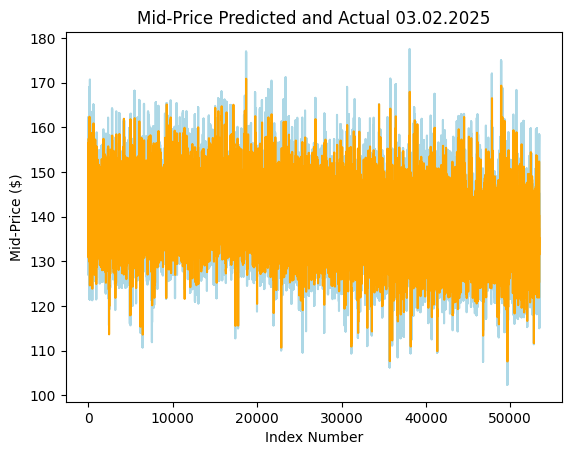

In [69]:
plt.plot(actuals_test, color = 'lightblue', label = 'Actual')
plt.plot(predictions_test, color = 'orange', label = 'Predicted')
plt.title('Mid-Price Predicted and Actual 03.02.2025')
plt.xlabel('Index Number')
plt.ylabel('Mid-Price ($)')
plt.show()

In [117]:
arima_test = pd.DataFrame({
    'ARIMA Mid-Price': predictions_test
})


Get data for Bid-Ask Spread

In [134]:
test_bid = arima_test_df['Bid_Ask_Spread']
test_bid.index = pd.to_datetime(test_data['DateTime_Minute'])  # Set datetime index if not already set
test_bid.head(20)

DateTime_Minute
2025-06-02 07:30:00    37.26
2025-06-02 07:31:00    48.09
2025-06-02 07:32:00    50.24
2025-06-02 07:33:00    75.87
2025-06-02 07:34:00    40.52
2025-06-02 07:35:00    95.43
2025-06-02 07:36:00    68.93
2025-06-02 07:37:00    67.67
2025-06-02 07:38:00    39.80
2025-06-02 07:39:00    46.92
2025-06-02 07:40:00    26.58
2025-06-02 07:41:00    49.55
2025-06-02 07:42:00    53.96
2025-06-02 07:43:00    61.31
2025-06-02 07:44:00    34.31
2025-06-02 07:45:00    31.30
2025-06-02 07:46:00    75.03
2025-06-02 07:47:00    60.29
2025-06-02 07:48:00    55.84
2025-06-02 07:49:00    64.35
Name: Bid_Ask_Spread, dtype: float64

In [135]:
horizon = 5  # Predicting the next 5 steps
training_window = 20  # Look back window for training

predictions_test_bid = []
actuals_test_bid = []

# Ensure the loop starts at 'training_window' to have the first set of 20 data points
for end in range(training_window, len(test_bid) - horizon + 1):
    
    # Extract current training data
    test_set_bid = test_bid.iloc[end - training_window:end]
    
    # Fit the ARIMA model with the chosen order
    model = ARIMA(test_set_bid, order=(1,1,0))  # Ensure you've chosen the best order
    model_fit = model.fit()
    
    # Forecast the next 5 points
    forecast_test_bid = model_fit.forecast(steps=horizon)
    
    # Append the forecasted values
    predictions_test_bid.extend(forecast_test_bid)  # Assuming 'forecast' returns a list of predictions
    
    # Append the actual values for comparison
    actuals_test_bid.extend(arima_test_df['Bid_Ask_Spread'].iloc[end:end + horizon])

C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache

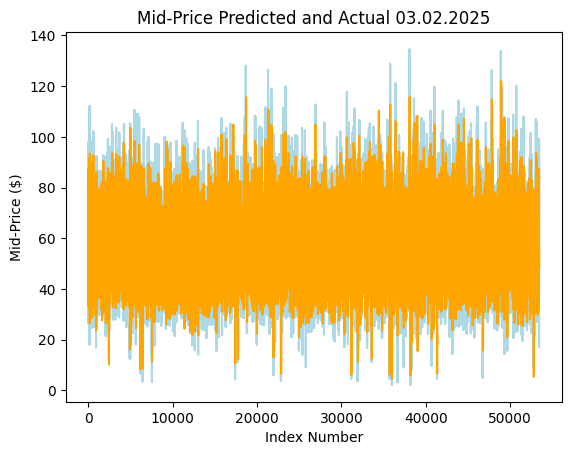

In [136]:
plt.plot(actuals_test_bid, color = 'lightblue', label = 'Actual')
plt.plot(predictions_test_bid, color = 'orange', label = 'Predicted')
plt.title('Mid-Price Predicted and Actual 03.02.2025')
plt.xlabel('Index Number')
plt.ylabel('Mid-Price ($)')
plt.show()

In [137]:
arima_test['ARIMA Bid_Ask_Spread'] = predictions_test_bid
arima_test.head(20)

arima_test.to_csv('ARIMA Test Result.csv')

In [138]:
def calculate_sortino_ratio(daily_returns, risk_free_rate=0.01):
    negative_returns = daily_returns[daily_returns < 0]
    downside_deviation = np.std(negative_returns, ddof=1)
    excess_daily_returns = daily_returns - risk_free_rate / 365
    sortino_ratio = np.mean(excess_daily_returns) / downside_deviation
    return sortino_ratio * np.sqrt(252)  # annualised

def calculate_sharpe_ratio(daily_returns, risk_free_rate=0.01):
    excess_daily_returns = daily_returns - risk_free_rate / 365
    sharpe_ratio = np.mean(excess_daily_returns) / np.std(excess_daily_returns, ddof=1)
    return sharpe_ratio * np.sqrt(252)  # annualised

def calculate_maximum_drawdown(cumulative_returns):
    cumulative_returns = np.array(cumulative_returns) + 1
    if len(cumulative_returns) > 0:
        running_max = np.maximum.accumulate(cumulative_returns)
        drawdowns = (running_max - cumulative_returns) / running_max
        max_drawdown = np.max(drawdowns)
        return max_drawdown
    else:
        return 0

def calculate_calmar_ratio(annual_return, max_drawdown):
    # if max_drawdown is negative, make it positive for the ratio
    return annual_return / abs(max_drawdown)

In [140]:
def run_trading_simulation(future_buy_increase, future_sell_decrease, quantile_optimised):
    # Initial conditions
    initial_cash = 10000  # Starting cash
    cash = initial_cash
    shares_owned = 0  # Starting shares owned
    transactions_arima = []  # List to record transactions_arima
    daily_portfolio_values = []  # Track daily portfolio values for performance metrics calculation
    buy_signals = 0
    sell_signals = 0

    # Parameters for market impact, slippage, and fees
    market_impact_constant = 0.1
    average_daily_volume = arima_test['ARIMA Mid-Price'].count()  # Using total count as a proxy
    brokerage_fee_bps = 0.005
    exchange_fee_per_share = 0.003
    shares_per_transaction = 100

    look_ahead_window = 5 
    look_back_window = 20
  
    for i in range(look_back_window, len(arima_test) - look_ahead_window):
        # Mid_price
        current_mid_price = arima_test.iloc[i]['ARIMA Mid-Price']
        future_prices = arima_test.iloc[i+1:i+look_ahead_window+1]['ARIMA Mid-Price']
        future_avg_price = future_prices.mean()

        # Bid_ask_spread      
        bid_ask_spread_threshold = arima_test.iloc[i-look_back_window:i]['ARIMA Bid_Ask_Spread'].quantile(quantile_optimised)
        future_bid_ask = arima_test.iloc[i+1:i+look_ahead_window+1]['ARIMA Bid_Ask_Spread']
        future_bid_ask_avg = future_bid_ask.mean()
        is_liquid = future_bid_ask_avg <= bid_ask_spread_threshold

        if future_avg_price > current_mid_price * future_buy_increase and is_liquid and cash > 0:
            # Buy condition
            shares_to_buy = min(shares_per_transaction, int(cash / (current_mid_price + brokerage_fee_bps * current_mid_price + exchange_fee_per_share)))
            volume_ratio = (shares_to_buy) / average_daily_volume
            price_impact = market_impact_constant * (volume_ratio ** 0.5) * current_mid_price
            adjusted_buy_price = current_mid_price + price_impact
            total_cost = adjusted_buy_price * shares_to_buy + brokerage_fee_bps * adjusted_buy_price * shares_to_buy + exchange_fee_per_share * shares_to_buy
            cash -= total_cost
            shares_owned += shares_to_buy
            transactions_arima.append(('Buy', shares_to_buy, adjusted_buy_price, total_cost, cash, i))
            buy_signals += 1

        elif future_avg_price < current_mid_price * future_sell_decrease and is_liquid and shares_owned > 0:
            # Sell condition
            shares_to_sell = min(shares_per_transaction, shares_owned)
            volume_ratio = shares_to_sell / average_daily_volume
            price_impact = market_impact_constant * (volume_ratio ** 0.5) * current_mid_price
            adjusted_sell_price = current_mid_price - price_impact
            total_revenue = adjusted_sell_price * shares_to_sell - brokerage_fee_bps * adjusted_sell_price * shares_to_sell - exchange_fee_per_share * shares_to_sell
            cash += total_revenue
            transactions_arima.append(('Sell', shares_to_sell, adjusted_sell_price, total_revenue, cash, i))
            shares_owned = 0
            sell_signals += 1

        # Hold condition
        else: 
            transactions_arima.append(('Hold', shares_owned, current_mid_price, 0, cash, i))

        # Update the portfolio value for each day
        portfolio_value = cash + shares_owned * current_mid_price
        daily_portfolio_values.append(portfolio_value)
    
    # Performance Metrics
    daily_returns = pd.Series(daily_portfolio_values).pct_change().dropna() # daily returns from portfolio values
    sortino_ratio = calculate_sortino_ratio(daily_returns)
    sharpe_ratio = calculate_sharpe_ratio(daily_returns)
    cumulative_returns = (1 + daily_returns).cumprod() - 1
    max_drawdown = calculate_maximum_drawdown(cumulative_returns)
    if len(arima_test) > 0 and (cumulative_returns.iloc[-1] + 1) > 0:
        annual_return = (cumulative_returns.iloc[-1] + 1) ** (365 / len(arima_test)) - 1
    else:
        # cases where annual return cannot be computed
        annual_return = None
    calmar_ratio = calculate_calmar_ratio(annual_return, max_drawdown)
    
    # Return the overall profit or loss for this simulation run
    final_valuation = cash + shares_owned * arima_test.iloc[-1]['ARIMA Mid-Price']
    return initial_cash, final_valuation, final_valuation - initial_cash, transactions_arima, buy_signals, sell_signals, sortino_ratio, sharpe_ratio, max_drawdown, calmar_ratio, daily_returns

# optimised parameters
future_buy_increase = 1.01
future_sell_decrease = 0.97
quantile_optimised = 0.85

# Run simulation
results = []
initial_cash, final_valuation, profit_loss, transactions_arima, buy_signals, sell_signals, sortino_ratio, sharpe_ratio, max_drawdown, calmar_ratio, daily_returns = run_trading_simulation(future_buy_increase, future_sell_decrease, quantile_optimised)

# Make trading signal 'Hold' as default
arima_test['ARIMA Trading Signal'] = 'Hold'
# update the DataFrame with transactions_arima for training of RF
for transaction in transactions_arima:
    signal_type, shares, price, cost, cash, day_index = transaction
    arima_test.at[day_index, 'ARIMA Trading Signal'] = signal_type

# Append results to a list
results.append((future_buy_increase, future_sell_decrease, quantile_optimised, profit_loss, len(transactions_arima), buy_signals, sell_signals, sortino_ratio, sharpe_ratio, max_drawdown, calmar_ratio))

# Output results
results_df = pd.DataFrame(results, columns=['Future Buy Increase', 'Future Sell Decrease', 'Bid Ask Spread Threshold', 'Profit/Loss', 'Number of Transactions', 'Number of Buy Signals', 'Number of Sell Signals', 'Sortino Ratio', 'Sharpe Ratio', 'Max Drawdown', 'Calmar Ratio'])
results_df.to_csv('ARIMA June Trading Simulation Results.csv')

# Output arima_test with signals
arima_test.to_csv('ARIMA June Data with Trading Signals.csv') 

results_df.head(50)


,Future Buy Increase,Future Sell Decrease,Bid Ask Spread Threshold,Profit/Loss,Number of Transactions,Number of Buy Signals,Number of Sell Signals,Sortino Ratio,Sharpe Ratio,Max Drawdown,Calmar Ratio
0,1.01,0.97,0.85,8051.795063,53405,12453,2459,0.201525,0.213437,0.477127,0.008474


In [129]:
signals = pd.read_csv("June Data with Trading Signals.csv")
arima_test['True Trading Signals'] = signals['Trading Signal']
arima_test.head(50)

,ARIMA Mid-Price,ARIMA Bid_Ask_Spread,ARIMA Trading Signal,True Trading Signals
0,143.398477,131.448472,Hold,Hold
1,145.013137,139.750039,Hold,Hold
2,144.117685,133.969235,Hold,Hold
3,144.614281,137.994703,Hold,Hold
4,144.338881,135.191565,Hold,Hold
5,142.586617,131.448472,Hold,Hold
6,139.796942,139.750039,Hold,Hold
7,141.383022,133.969235,Hold,Hold
8,140.481251,137.994703,Hold,Hold
9,140.993956,135.191565,Hold,Hold


In [130]:
accuracy = (arima_test['ARIMA Trading Signal'] == arima_test['True Trading Signals']).mean() * 100
print("Accuracy of ARIMA Trading Signal:", accuracy, "%")

Accuracy of ARIMA Trading Signal: 8.216357851394347 %


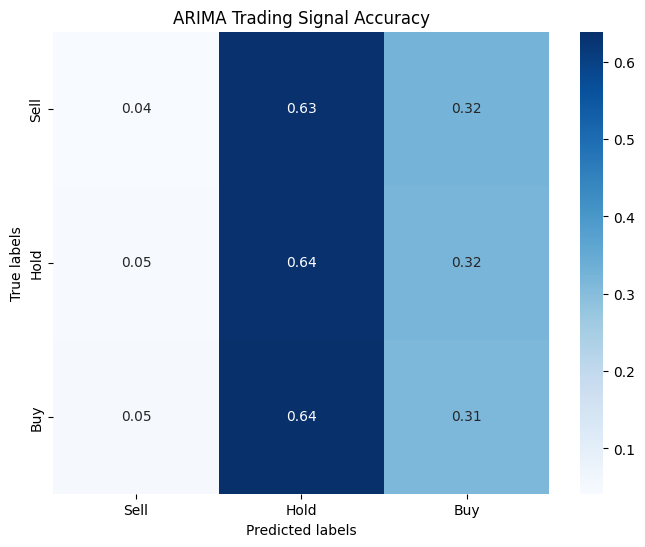

In [131]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

y_true = arima_test['True Trading Signals'].astype(str)
y_pred = arima_test['ARIMA Trading Signal'].astype(str)

labels = ['Sell', 'Hold', 'Buy']
cm = confusion_matrix(y_true, y_pred, labels=labels)
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Plotting
fig, ax = plt.subplots(figsize=(8, 6))
sns.heatmap(cm_normalized, annot=True, ax=ax, cmap="Blues", fmt=".2f")
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('ARIMA Trading Signal Accuracy')
ax.xaxis.set_ticklabels(labels)
ax.yaxis.set_ticklabels(labels)

plt.show()